# Progetto Datascience

## Gruppo
- Bryan Beffa
- Mattia Toscanelli

## Descrizione dataset
Informazioni su più di 180.000 attacchi terroristici (1 riga per ogni attacco)

Il Global Terrorism Database (GTD) è un database open-source che include informazioni sugli attacchi terroristici in tutto il mondo dal 1970 al 2017 (escluso il 1993). Il GTD include dati sistematici sugli incidenti terroristici nazionali e internazionali che si sono verificati durante questo periodo di tempo e ora comprende più di 180.000 attacchi. Il database è gestito dai ricercatori del Consorzio nazionale per lo studio del terrorismo e delle risposte al terrorismo (START), con sede presso l"Università del Maryland.

## Colonne importanti
- Date (Year, Month, Day) --> La data dell'attacco
- Latitude/Longitude --> latitudine e longitudine di dove è successo l'attacco
- Country --> La nazione dove è successo l'attacco
- Region --> La regione geografica (≠ continente) dove è successo l"attacco
- Target --> Il gruppo, l"obiettivo che ha subito l'attacco
- Killed --> Numero di vittime dell'attacco
- Weapon_type -> Arma utilizzata per l"attacco

### Librerie utilizzate
- Numpy
- Pandas
- Plotly
- Calendar

### Dataset Source
https://www.kaggle.com/datasets/START-UMD/gtd?datasetId=504&sortBy=voteCount (03.12.2022)<br>
https://www.kaggle.com/datasets/kaggleashwin/population-dataset (03.12.2022) --> Per proporzioni un base alla popolazione e mappe - 1 riga per ogni paese

<hr>

#### Import librerie

In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import calendar
import warnings

#### Import dati

In [2]:
df_terrorism = pd.read_csv("data/terrorism/globalterrorismdb_0718dist.csv",encoding="ISO-8859-1",low_memory=False)
df_population = pd.read_csv("data/terrorism/World-population-by-countries.csv")

#### Rinominazione colonne

In [3]:
df_terrorism.rename(columns={"iyear":"Year","imonth":"Month","iday":"Day","country_txt":"Country","region_txt":"Region","attacktype1_txt":"AttackType","target1":"Target","nkill":"Killed","nwound":"Wounded","summary":"Summary","gname":"Group","targtype1_txt":"Target_type","weaptype1_txt":"Weapon_type","motive":"Motive"},inplace=True)
df_terrorism = df_terrorism[["Year","Month","Day","Country","Region","city","latitude","longitude","AttackType","Killed","Wounded","Target","Summary","Group","Target_type","Weapon_type","Motive"]]
df_population.rename(columns={"Country Name": "Country", "Country Code": "iso_alpha"},inplace=True)

#### Modifiche utili

In [4]:
#Rinominazione città null
df_terrorism[df_terrorism["city"] is None] = "Unkown"

#Rimozione attacchi in cui non si conosce il mese
df_terrorism=df_terrorism[df_terrorism["Month"] != 0]

#Rinominazione mesi
df_terrorism = df_terrorism.sort_values(["Year", "Month", "Day"])
df_terrorism["Month"] = df_terrorism["Month"].apply(lambda x: calendar.month_abbr[x])

#Rinominazione continente
df_terrorism.loc[df_terrorism["Region"].str.contains("Asia"), "Region"] = "Asia"
df_terrorism.loc[df_terrorism["Region"].str.contains("Africa"), "Region"] = "Africa"
df_terrorism.loc[df_terrorism["Region"].str.contains("America"), "Region"] = "America"
df_terrorism.loc[df_terrorism["Region"].str.contains("Europe"), "Region"] = "Europe"
df_terrorism.loc[df_terrorism["Region"].str.contains("Oceania"), "Region"] = "Oceania"

#Rinominazione nazioni
df_terrorism.loc[df_terrorism["Country"].str.contains("Soviet Union"), "Country"] = "Russia"
df_terrorism.loc[df_terrorism["Country"].str.contains("Germany"), "Country"] = "Germany"

#Rinominazione armi utilizzate
df_terrorism.loc[df_terrorism["Weapon_type"].str.contains("Vehicle"), "Weapon_type"] = "Vehicle"

#Ignore warning
warnings.filterwarnings("ignore")

<hr>

## Analisi tabelle

#### Colonne dataset terrorism

In [5]:
df_terrorism.columns

Index([       'Year',       'Month',         'Day',     'Country',
            'Region',        'city',    'latitude',   'longitude',
        'AttackType',      'Killed',     'Wounded',      'Target',
           'Summary',       'Group', 'Target_type', 'Weapon_type',
            'Motive',         False],
      dtype='object')

#### Numero righe terrorism

In [6]:
len(df_terrorism.index)

181671

#### Esempio sample terrorism

In [7]:
df_terrorism.sample(5)

,Year,Month,Day,Country,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,False
146608,2015,Apr,10,Ukraine,Europe,Olenivka,47.827862,37.652819,Bombing/Explosion,0.0,0.0,Railway Tracks,04/10/2015: An explosive device planted along ...,Unknown,Transportation,Explosives,NaN,Unkown
76633,2004,Jun,14,Turkey,Africa,Istanbul,41.106178,28.689863,Bombing/Explosion,0.0,1.0,Civilians in Istanbul,06/14/2004: A bomb that was placed among garba...,Unknown,Business,Explosives,Unknown,Unkown
21953,1984,May,8,Chile,America,Santiago,-33.366238,-70.505302,Bombing/Explosion,NaN,NaN,street,NaN,Manuel Rodriguez Patriotic Front (FPMR),Private Citizens & Property,Explosives,NaN,Unkown
157803,2016,Jan,16,Afghanistan,Asia,Sangin district,32.140817,65.021475,Bombing/Explosion,0.0,0.0,Unknown,01/16/2016: An unknown number of landmines wer...,Unknown,Unknown,Explosives,NaN,Unkown
47255,1991,Jul,16,Netherlands,Europe,Amsterdam,52.370216,4.895168,Facility/Infrastructure Attack,0.0,0.0,Branch,NaN,Dev Sol,Business,Incendiary,NaN,Unkown


#### Colonne dataset population 
Ogni colonna rappresenta la popolazione in quel determinato anno.

In [8]:
df_population.columns

Index(['Country', 'iso_alpha', '1960', '1961', '1962', '1963', '1964', '1965',
       '1966', '1967', '1968', '1969', '1970', '1971', '1972', '1973', '1974',
       '1975', '1976', '1977', '1978', '1979', '1980', '1981', '1982', '1983',
       '1984', '1985', '1986', '1987', '1988', '1989', '1990', '1991', '1992',
       '1993', '1994', '1995', '1996', '1997', '1998', '1999', '2000', '2001',
       '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010',
       '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018', '2019',
       '2020', '2021'],
      dtype='object')

#### Numero righe population

In [9]:
len(df_population.index)

266

#### Esempio sample population

In [10]:
df_population.sample(5)

,Country,iso_alpha,1960,1961,1962,1963,1964,1965,1966,1967,...,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021
196,West Bank and Gaza,PSE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,3979998.0,4076708.0,4173398.0,4270092.0,4367088.0,4454805.0,4569087.0,4685306.0,4803269.0,4922749.0
211,El Salvador,SLV,2766319.0,2846601.0,2931187.0,3019224.0,3109571.0,3201310.0,3293954.0,3387384.0,...,6237922.0,6266076.0,6295124.0,6325121.0,6356137.0,6388124.0,6420740.0,6453550.0,6486201.0,6518500.0
7,Arab World,ARB,92197715.0,94724540.0,97334438.0,100034191.0,102832792.0,105736428.0,108758634.0,111899335.0,...,371437642.0,379696477.0,387899835.0,396028301.0,404042892.0,411942825.0,419851989.0,427870273.0,436080728.0,444517783.0
56,Djibouti,DJI,83634.0,88503.0,94203.0,100618.0,107582.0,114976.0,122876.0,131405.0,...,868136.0,883296.0,898707.0,913998.0,929117.0,944100.0,958923.0,973557.0,988002.0,1002197.0
232,Togo,TGO,1580508.0,1597523.0,1612761.0,1631758.0,1662073.0,1708631.0,1774020.0,1855450.0,...,6773807.0,6954721.0,7137997.0,7323162.0,7509952.0,7698476.0,7889095.0,8082359.0,8278737.0,8478242.0


<hr>

## Analisi generali

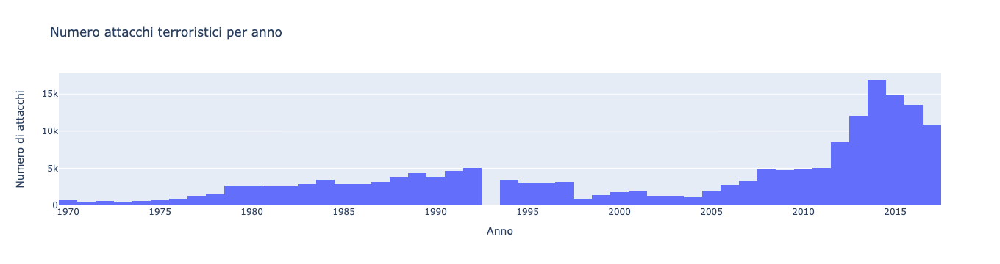

In [11]:
fig = px.histogram(df_terrorism, x="Year", title="Numero attacchi terroristici per anno")
fig.layout["xaxis"]["title"] = "Anno"
fig.layout["yaxis"]["title"] = "Numero di attacchi"
fig

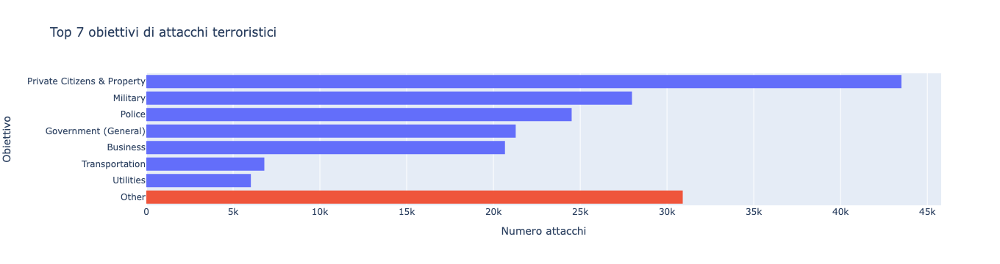

In [12]:
#Top 7 obbiettivi
df_tt_all = df_terrorism.groupby(["Target_type"]).size().to_frame().sort_values([0], ascending = False).reset_index()
df_tt = df_tt_all.head(7)
df_tt.columns = ["Target_type", "Count"]

#Raggruppamento restanti obbiettivi
df_tt_all = df_tt_all.iloc[7:]
df_tt_all["Target_type"] = "Other"
new_row = pd.DataFrame([["Other", (df_tt_all.groupby(["Target_type"]).sum()[0]["Other"])]], columns=["Target_type", "Count"])
df_tt = pd.concat([df_tt, new_row], ignore_index=True)

#Cambiamento colore per Other
df_tt["Color"] = "1"
df_tt.loc[df_tt["Target_type"] == "Other", "Color"] = "2"

fig = px.histogram(df_tt, y="Target_type", x="Count", color="Color", title="Top 7 obiettivi di attacchi terroristici")
fig.layout["xaxis"]["title"] = "Numero attacchi"
fig.layout["yaxis"]["title"] = "Obiettivo"
fig.layout["yaxis"]["autorange"] = "reversed"
fig.update_layout(showlegend=False)
fig

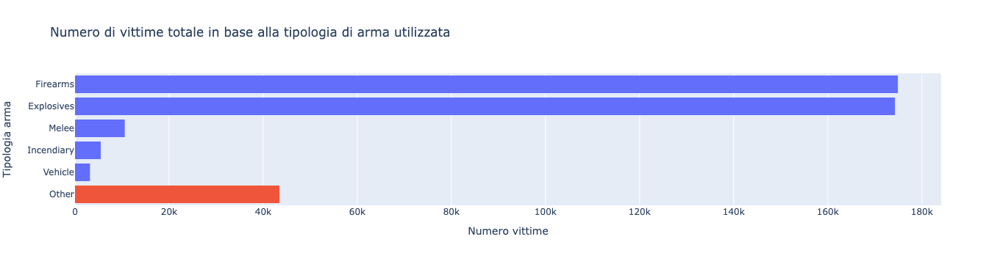

In [13]:
#Raggruppamento arma utilizzata per numero di vittime
df_wp = df_terrorism[["Weapon_type", "Killed"]]
df_wp.loc[df_wp["Weapon_type"].str.contains("Unknown"), "Weapon_type"] = "Other"
df_wp = df_wp[~df_wp["Killed"].isnull()]
df_wp_all = df_wp.groupby(["Weapon_type"])["Killed"].sum().reset_index().sort_values(by=["Killed"], ascending = False)

#Top 5 vittime
df_wp = df_wp_all.head(6)

#Raggruppamento restanti obbiettivi
df_wp_all = df_wp_all.iloc[6:]
df_wp_all["Weapon_type"] = "Other"
df_wp_all = pd.concat([df_wp, df_wp_all], ignore_index=True)
df_wp_all = df_wp_all.groupby(["Weapon_type"])["Killed"].sum().reset_index().sort_values(by=["Killed"], ascending = False)
df_wp_all_wu = df_wp_all[df_wp_all["Weapon_type"] != "Other"]
df_wp_all_ws = pd.concat([df_wp_all_wu, df_wp_all[df_wp_all["Weapon_type"] == "Other"]], ignore_index=True)

#Cambiamento colore per Other
df_wp_all_ws["Color"] = "1"
df_wp_all_ws.loc[df_wp_all_ws["Weapon_type"] == "Other", "Color"] = "2"

fig = px.histogram(df_wp_all_ws, y="Weapon_type", x="Killed", color="Color", title="Numero di vittime totale in base alla tipologia di arma utilizzata")
fig.layout["xaxis"]["title"] = "Numero vittime"
fig.layout["yaxis"]["title"] = "Tipologia arma"
fig.layout["yaxis"]["autorange"] = "reversed"
fig.update_layout(showlegend=False)
fig

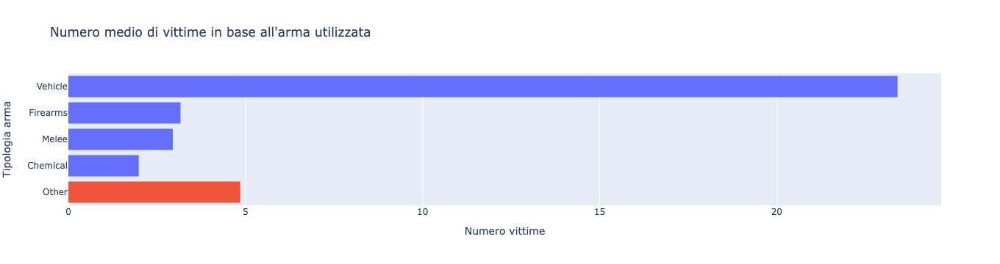

In [14]:
#Raggruppamento arma utilizzata per numero di vittime
df_wp = df_terrorism[["Weapon_type", "Killed"]]
df_wp.loc[df_wp["Weapon_type"].str.contains("Unknown"), "Weapon_type"] = "Other"
df_wp = df_wp[~df_wp["Killed"].isnull()]
df_wp_all = df_wp.groupby(["Weapon_type"])["Killed"].mean().reset_index().sort_values(by=["Killed"], ascending = False)
df_wp_top5 = df_wp_all.head(5)

#Raggruppamento restanti 
df_wp_ot = df_wp_all.iloc[6:]
df_wp_ot["Weapon_type"] = "Other"
df_wp_ot = df_wp_ot.groupby(["Weapon_type"])["Killed"].sum().reset_index().sort_values(by=["Killed"], ascending = False)
df_wp_all = pd.concat([df_wp_ot, df_wp_top5], ignore_index=True)
df_wp_all = df_wp_all.groupby(["Weapon_type"])["Killed"].sum().reset_index().sort_values(by=["Killed"], ascending = False)
df_wp_all_wo = df_wp_all[df_wp_all["Weapon_type"] != "Other"]
df_wp_all = pd.concat([df_wp_all_wo, df_wp_all[df_wp_all["Weapon_type"] == "Other"]], ignore_index=True)

#Raggruppamento restanti 
df_wp_all["Color"] = "1"
df_wp_all.loc[df_wp_all["Weapon_type"] == "Other", "Color"] = "2"

#Cambiamento colore per Othe
fig = px.histogram(df_wp_all, y="Weapon_type", x="Killed", color="Color", title="Numero medio di vittime in base all'arma utilizzata")
fig.layout["xaxis"]["title"] = "Numero vittime"
fig.layout["yaxis"]["title"] = "Tipologia arma"
fig.layout["yaxis"]["autorange"] = "reversed"
fig.update_layout(showlegend=False)
fig

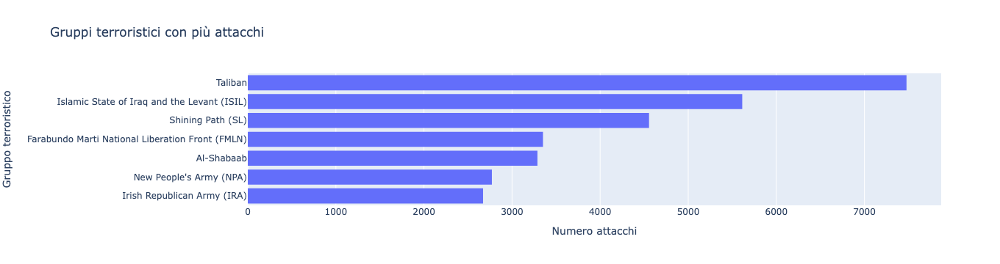

In [15]:
#Raggruppamento per gruppo terroristico
df_tg_all = df_terrorism.groupby(["Group"]).size().to_frame().sort_values([0], ascending = False).reset_index()
df_tg = df_tg_all.iloc[1:]

#Raggruppamento restanti gruppi
df_tg_all = df_tg.head(7)
df_tg_all.columns = ["Group", "Count"]

fig = px.histogram(df_tg_all, y="Group", x="Count", title="Gruppi terroristici con più attacchi")
fig.layout["xaxis"]["title"] = "Numero attacchi"
fig.layout["yaxis"]["title"] = "Gruppo terroristico"
fig.layout["yaxis"]["autorange"] = "reversed"
fig.update_layout(showlegend=False)
fig

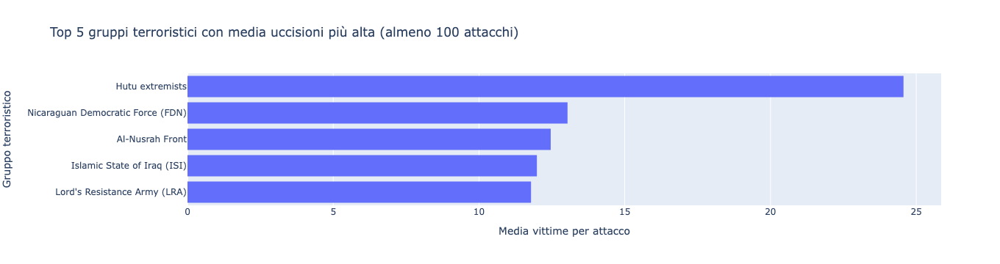

In [16]:
#Top 7 gruppi terroristici più letali (media morti più alta)
df_gk = df_terrorism[["Group", "Killed"]]
df_gk = df_gk[~df_gk["Killed"].isnull()]
df_gk_all = df_gk.groupby(["Group"])["Killed"].mean().reset_index().sort_values(by=["Killed"], ascending = False)

#Numero di attacchi per gruppo terroristico
df_gk_count = df_terrorism[["Group", "Killed"]]
df_gk_count = df_gk_count[~df_gk_count["Killed"].isnull()]
df_gk_count_all = df_gk.groupby(["Group"]).size().reset_index().sort_values(by=[0], ascending = False)
df_gk_count_all.columns = ["Group", "Count"]
df_gk_merged = pd.merge(df_gk_count_all, df_gk_all, how="left", on="Group")
df_gk_merged.columns = ["Group", "Count", "AvgKilled"]
df_gk_merged = df_gk_merged.sort_values(by=["AvgKilled"], ascending = False)

#Gruppi con almeno 100 attacchi
min_num_attacks = 100
df_gk_attacks = df_gk_merged[df_gk_merged["Count"] >= min_num_attacks].sort_values(by=["AvgKilled"], ascending = False)
df_gk_attacks = df_gk_attacks.head(5)

fig = px.histogram(df_gk_attacks, y="Group", x="AvgKilled", title="Top 5 gruppi terroristici con media uccisioni più alta (almeno 100 attacchi)")
fig.layout["xaxis"]["title"] = "Media vittime per attacco"
fig.layout["yaxis"]["title"] = "Gruppo terroristico"
fig.layout["yaxis"]["autorange"] = "reversed"
fig.update_layout(showlegend=False)
fig

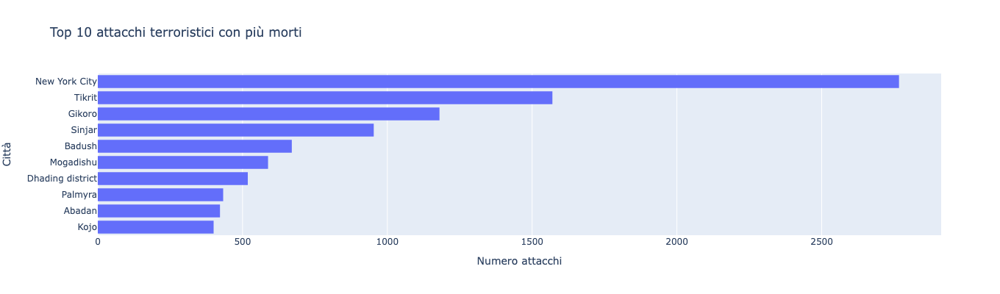

In [17]:
#Top 10 attacchi con piu morti
dfk = df_terrorism[["city","Killed", "Year"]]
dfk = dfk[dfk["city"] != "Unknown"]
dfk = dfk.sort_values(by=["Killed"], ascending=False).head(11).reset_index() #11 perché l'attacco di New York è suddiso in due ma noi lo uniamo

fig = px.histogram(dfk, y="city", x="Killed", title="Top 10 attacchi terroristici con più morti", hover_data=["Year"], height=400).update_yaxes(categoryorder="total ascending")
fig.layout["xaxis"]["title"] = "Numero attacchi"
fig.layout["yaxis"]["title"] = "Città"
fig

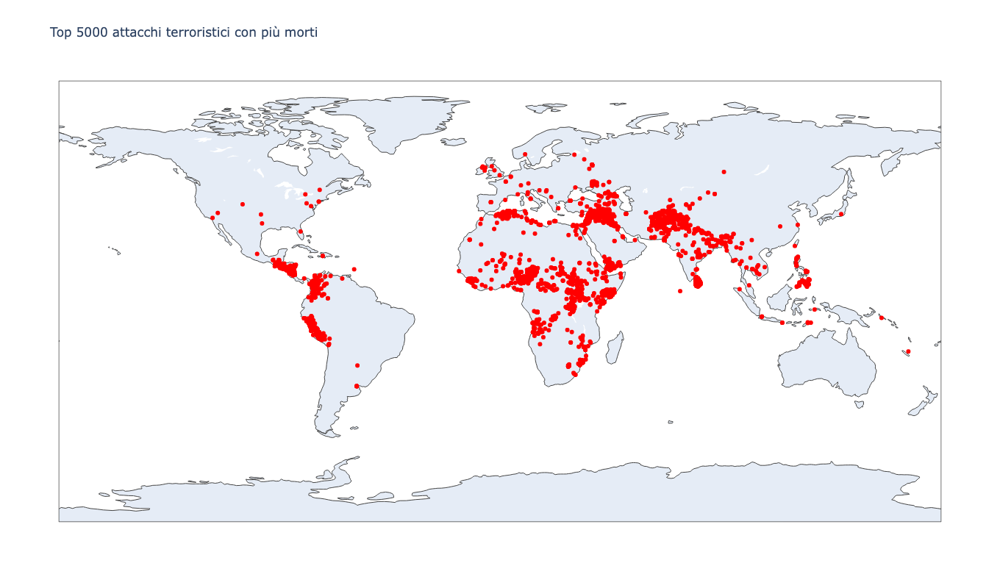

In [18]:
#Top 5000 attacchi con più morti
dfk = df_terrorism[["city","Killed", "Year", "latitude", "longitude", "Country"]]
dfk = dfk[dfk["city"] != "Unknown"]
dfk = dfk.sort_values(by=["Killed"], ascending=False).head(5000).reset_index()

fig = px.scatter_geo(dfk,
                    lat=dfk["latitude"],
                    lon=dfk["longitude"],
                    hover_data=["city", "Killed", "Country"],
                    title="Top 5000 attacchi terroristici con più morti")
fig.update_traces(marker_color="red")
fig.update_layout(
    height=800)
fig

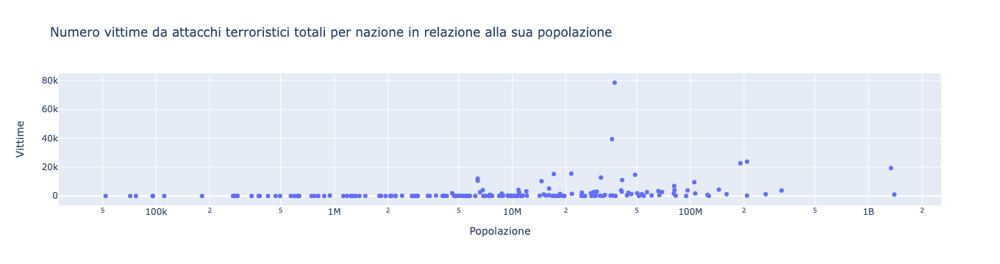

In [19]:
#Raggurppamento nazioni per numero di vittime totali
df_tw = df_terrorism[["Country", "Killed"]]
df_tw = df_tw.groupby("Country")["Killed"].sum().reset_index()
df_pop = df_population[["Country", "2017"]]
df_merg = pd.merge(df_tw, df_pop, how="left", on="Country")
df_merg = df_merg[~df_merg["2017"].isnull()]

fig = px.scatter(df_merg, x="2017", y="Killed", hover_data=["Country"], log_x=True, title="Numero vittime da attacchi terroristici totali per nazione in relazione alla sua popolazione")
fig.layout["xaxis"]["title"] = "Popolazione"
fig.layout["yaxis"]["title"] = "Vittime"
fig

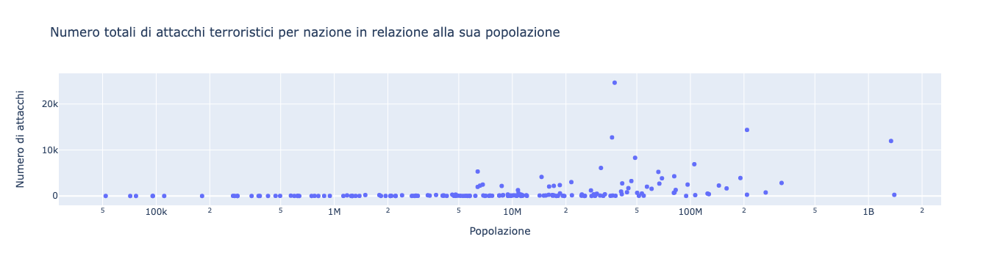

In [20]:
#Raggruppamento nazioni per numero di attacchi
df_tw = df_terrorism[["Country"]]
df_tw["Numero di attacchi"] = df_tw.groupby("Country")["Country"].transform("count")
dfw = df_tw.drop_duplicates()

df_pop = df_population[["Country", "2017"]]
df_merg = pd.merge(dfw, df_pop, how="left", on="Country")
df_merg = df_merg[~df_merg["2017"].isnull()]
fig = px.scatter(df_merg, x="2017", y="Numero di attacchi", hover_data=["Country"], log_x=True, title="Numero totali di attacchi terroristici per nazione in relazione alla sua popolazione")
fig.layout["xaxis"]["title"] = "Popolazione"
fig

<hr>

## Analisi temporali

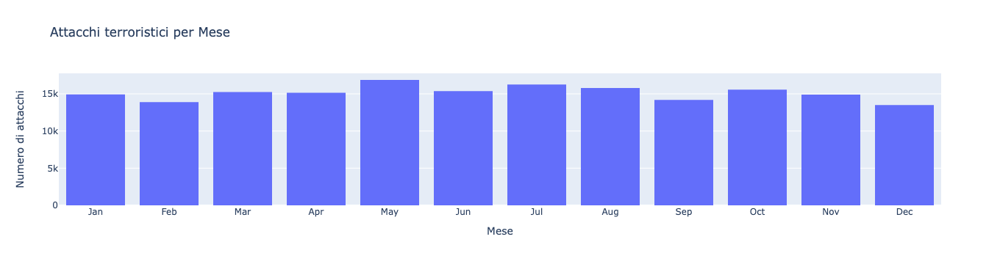

In [21]:
fig = px.histogram(df_terrorism[df_terrorism["Month"] != 0], x="Month", title="Attacchi terroristici per Mese")
fig.layout["yaxis"]["title"] = "Numero di attacchi"
fig.layout["xaxis"]["title"] = "Mese"
fig

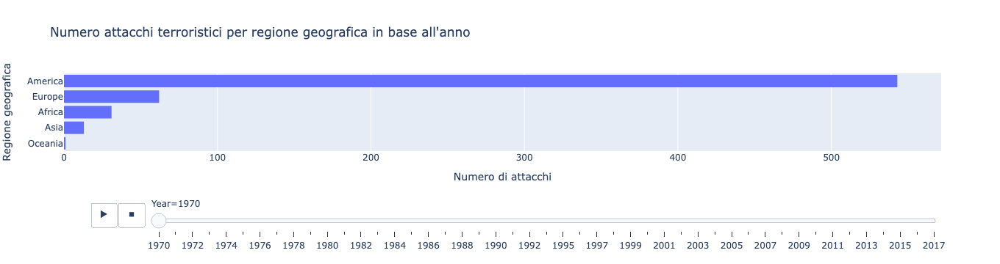

In [22]:
fig = px.histogram(df_terrorism, y="Region", title="Numero attacchi terroristici per regione geografica in base all'anno", animation_frame="Year").update_yaxes(categoryorder="total ascending")
fig.layout["yaxis"]["title"] = "Regione geografica"
fig.layout["xaxis"]["title"] = "Numero di attacchi"
fig

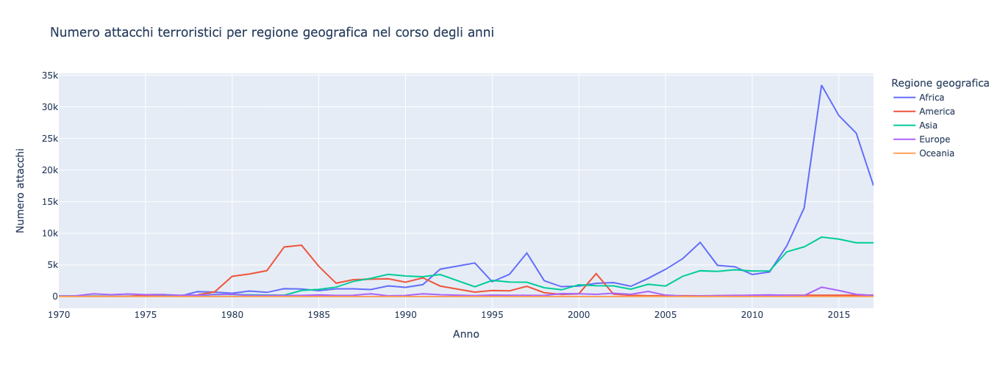

In [23]:
#Ragruppamento per regione geografica
df_country_by_year = df_terrorism.groupby(["Year", "Region"])["Killed"].sum().reset_index().sort_values(by=["Year"], ascending = True)
df_country_by_year = df_country_by_year.sort_values(by=["Region", "Year"], ascending = True)

fig = px.line(df_country_by_year, x="Year", y="Killed" , color="Region", title="Numero attacchi terroristici per regione geografica nel corso degli anni")
fig.layout["xaxis"]["title"] = "Anno"
fig.layout["yaxis"]["title"] = "Numero attacchi"
fig.layout["legend"]["title"] = "Regione geografica"
fig.update_layout(
    height=500)
fig

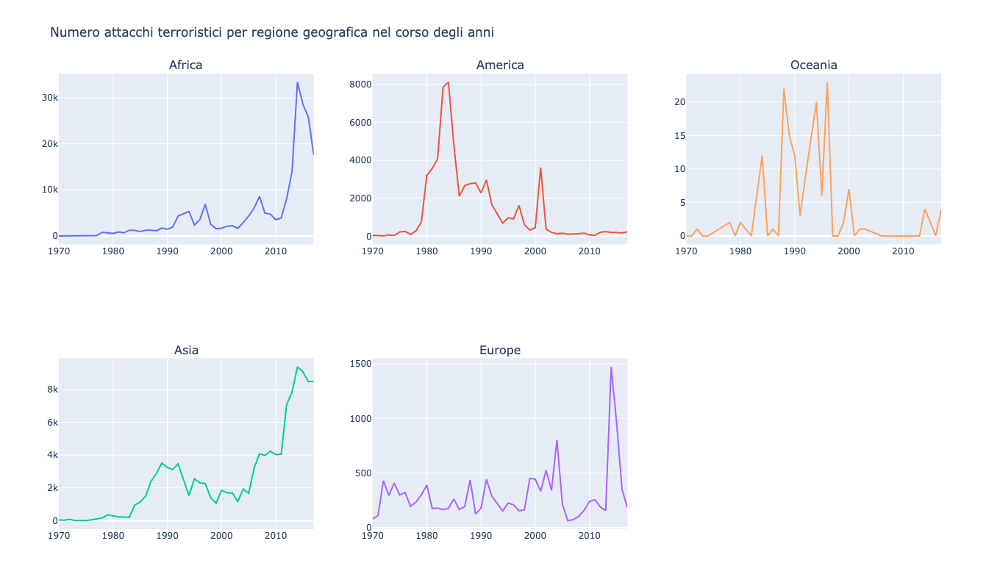

In [24]:
fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=("Africa", "America", "Oceania", "Asia", "Europe"))

fig.append_trace(go.Scatter(
    x=df_country_by_year[df_country_by_year["Region"] == "Africa"]["Year"], 
    y=df_country_by_year[df_country_by_year["Region"] == "Africa"]["Killed"],
), row=1, col=1)

fig.append_trace(go.Scatter(
    x=df_country_by_year[df_country_by_year["Region"] == "America"]["Year"], 
    y=df_country_by_year[df_country_by_year["Region"] == "America"]["Killed"],
), row=1, col=2)

fig.append_trace(go.Scatter(
    x=df_country_by_year[df_country_by_year["Region"] == "Asia"]["Year"], 
    y=df_country_by_year[df_country_by_year["Region"] == "Asia"]["Killed"],
), row=2, col=1)

fig.append_trace(go.Scatter(
    x=df_country_by_year[df_country_by_year["Region"] == "Europe"]["Year"], 
    y=df_country_by_year[df_country_by_year["Region"] == "Europe"]["Killed"],
), row=2, col=2)

fig.append_trace(go.Scatter(
    x=df_country_by_year[df_country_by_year["Region"] == "Oceania"]["Year"], 
    y=df_country_by_year[df_country_by_year["Region"] == "Oceania"]["Killed"],
), row=1, col=3)

fig.update_layout(title_text="Numero attacchi terroristici per regione geografica nel corso degli anni")
fig.update_layout(
    showlegend=False,
    height=800)
fig

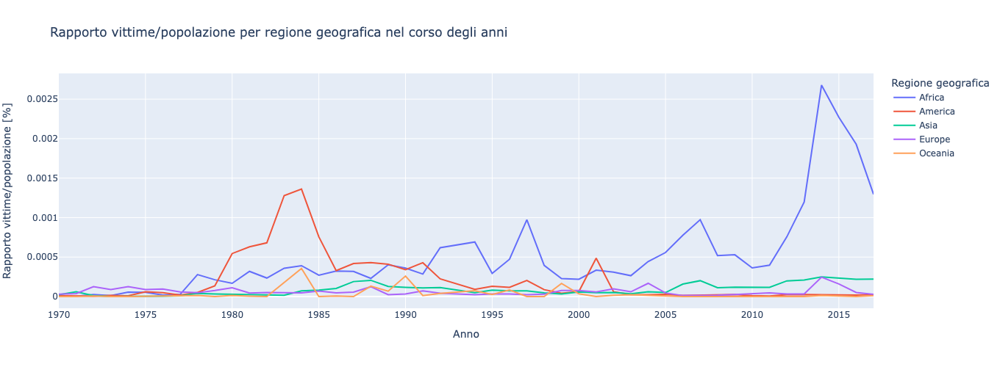

In [25]:
#Raggruppamento regione per numero di morti
df_country_by_year = df_terrorism.groupby(["Country", "Year", "Region"])["Killed"].sum().reset_index().sort_values(by=["Year"], ascending = True)
df_country_by_year["Population"] = 0
df_country_by_year

#Calcolo della popolazione per ogni continenete (somma di tutte le pololazioni delle nazioni)
for index, row in df_country_by_year.iterrows():
    year = str(row["Year"])
    country = row["Country"]
    if (len(df_population[df_population["Country"] == country][year].values) > 0):
        df_country_by_year["Population"][index] = df_population[df_population["Country"] == country][year].values[0]

#Calcolo Ratio
df_country_by_year = df_country_by_year.groupby(["Region","Year"])["Killed","Population"].sum().reset_index().sort_values(by=["Year"], ascending = True)
df_country_by_year["Ratio"] = df_country_by_year["Killed"] / df_country_by_year["Population"] * 100
df_country_by_year = df_country_by_year.sort_values(by=["Region", "Year"], ascending = True)

fig = px.line(df_country_by_year, 
              x="Year", 
              y="Ratio", 
              color="Region", 
              title="Rapporto vittime/popolazione per regione geografica nel corso degli anni", 
              labels={"Country" : "Regione"})
fig.layout["xaxis"]["title"] = "Anno"
fig.layout["yaxis"]["title"] = "Rapporto vittime/popolazione [%]"
fig.layout["legend"]["title"] = "Regione geografica"
fig.update_layout(
    height=500)
fig

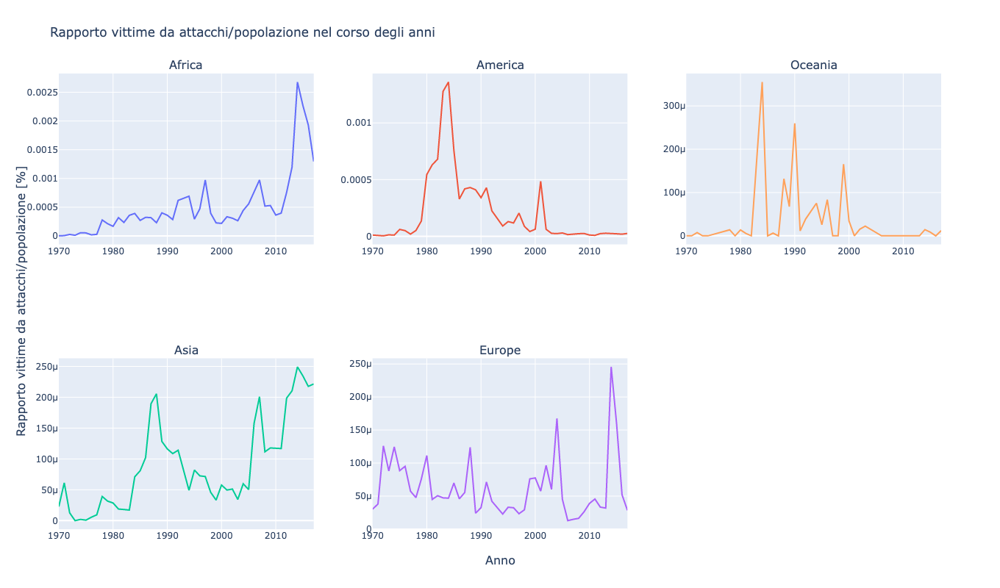

In [26]:
fig = make_subplots(
    rows=2, cols=3,
    subplot_titles=("Africa", "America", "Oceania", "Asia", "Europe"),
    x_title="Anno",
    y_title="Rapporto vittime da attacchi/popolazione [%]",)

fig.append_trace(go.Scatter(
    x=df_country_by_year[df_country_by_year["Region"] == "Africa"]["Year"], 
    y=df_country_by_year[df_country_by_year["Region"] == "Africa"]["Ratio"],
), row=1, col=1)

fig.append_trace(go.Scatter(
    x=df_country_by_year[df_country_by_year["Region"] == "America"]["Year"], 
    y=df_country_by_year[df_country_by_year["Region"] == "America"]["Ratio"],
), row=1, col=2)

fig.append_trace(go.Scatter(
    x=df_country_by_year[df_country_by_year["Region"] == "Asia"]["Year"], 
    y=df_country_by_year[df_country_by_year["Region"] == "Asia"]["Ratio"],
), row=2, col=1)

fig.append_trace(go.Scatter(
    x=df_country_by_year[df_country_by_year["Region"] == "Europe"]["Year"], 
    y=df_country_by_year[df_country_by_year["Region"] == "Europe"]["Ratio"],
), row=2, col=2)

fig.append_trace(go.Scatter(
    x=df_country_by_year[df_country_by_year["Region"] == "Oceania"]["Year"], 
    y=df_country_by_year[df_country_by_year["Region"] == "Oceania"]["Ratio"],
), row=1, col=3)


fig.update_layout(title_text="Rapporto vittime da attacchi/popolazione nel corso degli anni")
fig.update_layout( 
    showlegend=False, 
    height=800)
fig

<hr>

## Analisi geografica

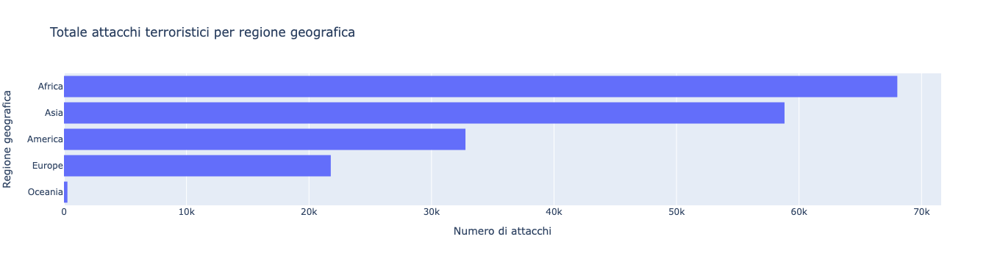

In [27]:
fig = px.histogram(df_terrorism, y="Region", title="Totale attacchi terroristici per regione geografica").update_yaxes(categoryorder="total ascending")
fig.layout["yaxis"]["title"] = "Regione geografica"
fig.layout["xaxis"]["title"] = "Numero di attacchi"
fig

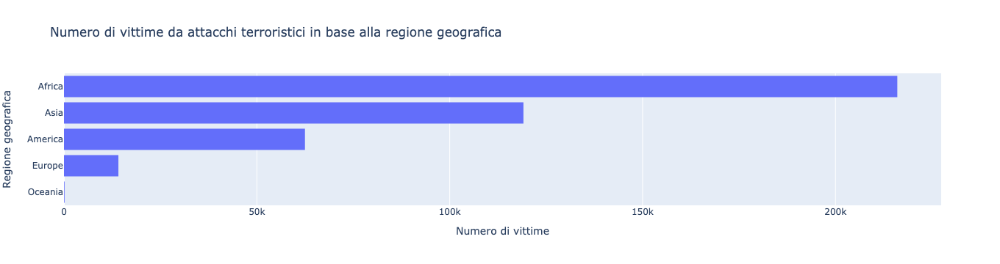

In [28]:
#Raggruppamento numero di vittime per regione geografica
df_region = df_terrorism.groupby(["Region"])["Killed"].sum().reset_index().sort_values(by=["Killed"], ascending = False)

fig = px.histogram(df_region, y="Region", x="Killed", title="Numero di vittime da attacchi terroristici in base alla regione geografica").update_yaxes(categoryorder="total ascending")
fig.layout["xaxis"]["title"] = "Numero di vittime"
fig.layout["yaxis"]["title"] = "Regione geografica"
fig

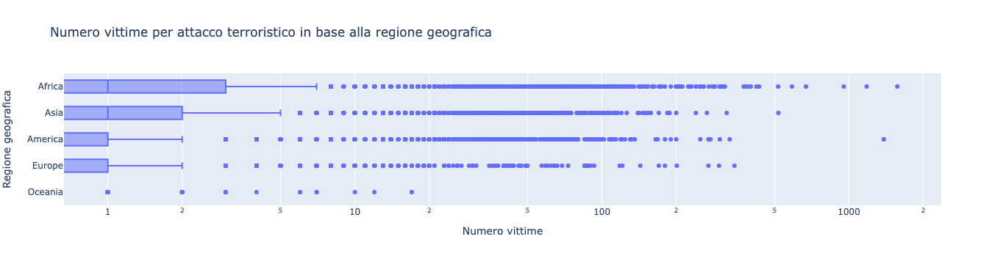

In [29]:
fig = px.box(df_terrorism, y="Region", x="Killed", title="Numero vittime per attacco terroristico in base alla regione geografica", log_x=True).update_yaxes(categoryorder="total ascending")
fig.layout["xaxis"]["title"] = "Numero vittime"
fig.layout["yaxis"]["title"] = "Regione geografica"
fig

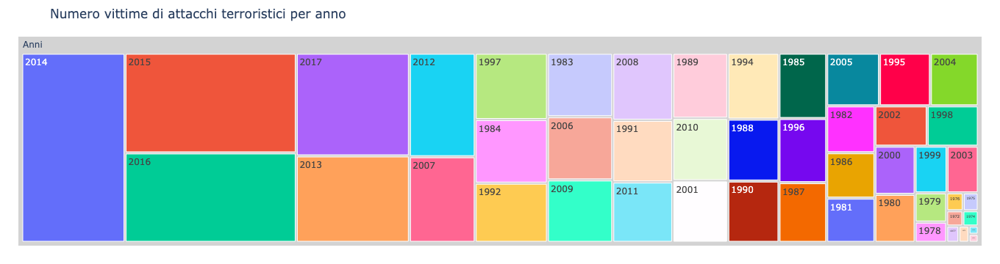

In [30]:
fig = px.treemap(df_terrorism, path=[px.Constant("Anni"), "Year"], values="Killed", title="Numero vittime di attacchi terroristici per anno")
fig.update_traces(root_color="lightgrey")
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig

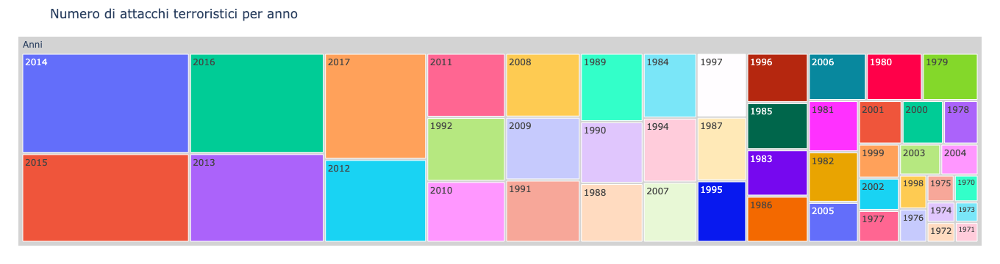

In [31]:
fig = px.treemap(df_terrorism, path=[px.Constant("Anni"), "Year"], title="Numero di attacchi terroristici per anno")
fig.update_traces(root_color="lightgrey")
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig

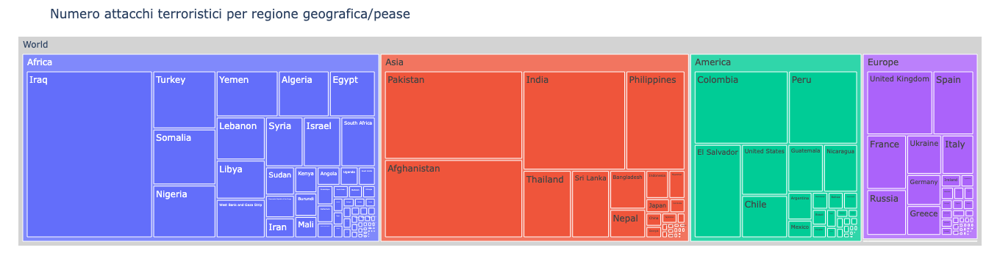

In [32]:
fig = px.treemap(df_terrorism, path=[px.Constant("World"), "Region", "Country"], title="Numero attacchi terroristici per regione geografica/pease")
fig.update_traces(root_color="lightgrey")
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig

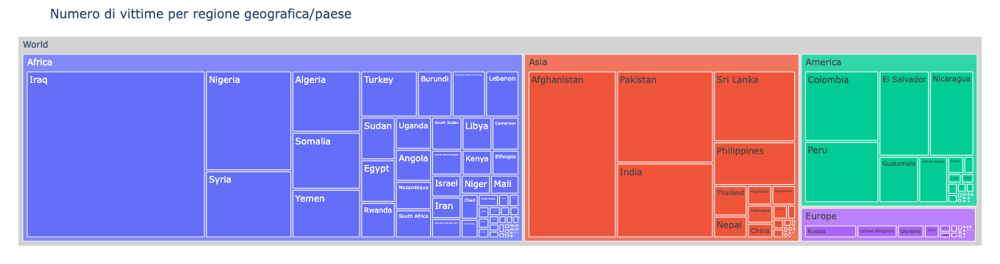

In [33]:
fig = px.treemap(df_terrorism, path=[px.Constant("World"), "Region", "Country"], values="Killed", title="Numero di vittime per regione geografica/paese")
fig.update_traces(root_color="lightgrey")
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig

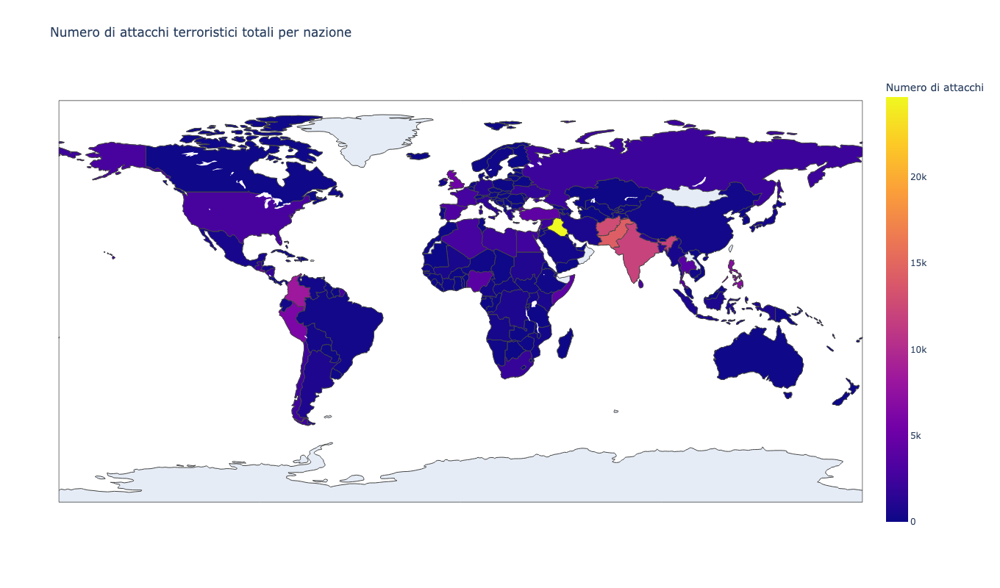

In [34]:
#Raggruppamento numero di attacchi per nazione
df_tw = df_terrorism[["Country"]]
df_tw["Numero di attacchi"] = df_tw.groupby("Country")["Country"].transform("count")
dfw = df_tw.drop_duplicates()

#Unione con dataset popolazione per iso_alpha
df_wm =pd.merge(df_population, dfw, how="left", on="Country")

fig = px.choropleth(df_wm, locations="iso_alpha",
                    color="Numero di attacchi",
                    hover_name="Country", # column to add to hover information
                    color_continuous_scale=px.colors.sequential.Plasma,
                    title="Numero di attacchi terroristici totali per nazione")
fig.update_layout(
    height=800)
fig

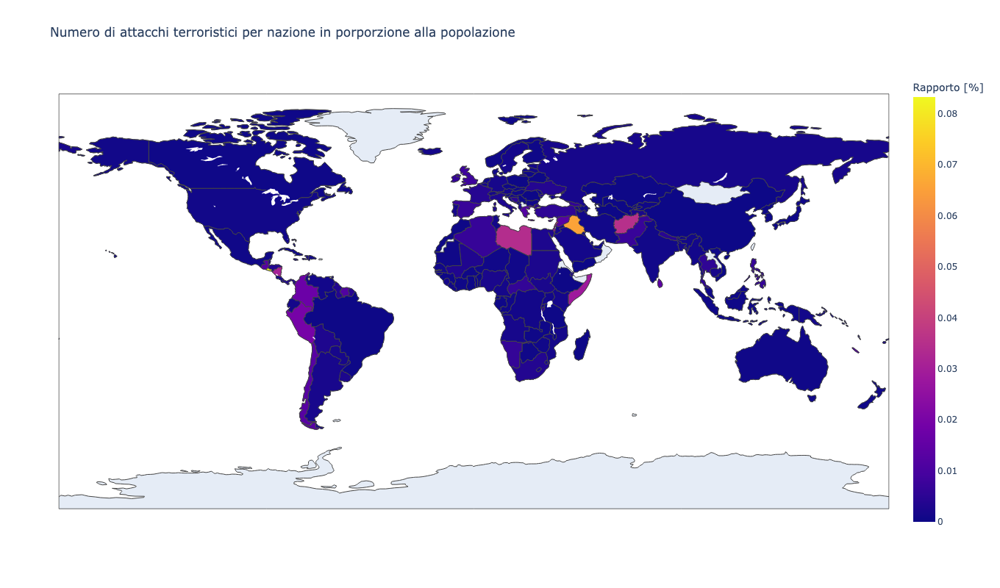

In [35]:
#Raggruppamento numero di attacchi per nazione
df_tw = df_terrorism[["Country"]]
df_tw["Numero di attacchi"] = df_tw.groupby("Country")["Country"].transform("count")
dfw = df_tw.drop_duplicates()

#Unione con dataset popolazione per iso_alpha e popolazioni
df_wm = pd.merge(df_population, dfw, how="left", on="Country")
df_wm["Rapporto [%]"] = (df_wm["Numero di attacchi"]/df_wm["2017"]*100)

fig = px.choropleth(df_wm, locations="iso_alpha",
                    color=df_wm["Rapporto [%]"], #elevato per mostrare meglio le differenze
                    hover_name="Country",
                    color_continuous_scale=px.colors.sequential.Plasma,
                    title="Numero di attacchi terroristici per nazione in porporzione alla popolazione")
fig.update_layout(
    showlegend=False,
    height=800)
fig

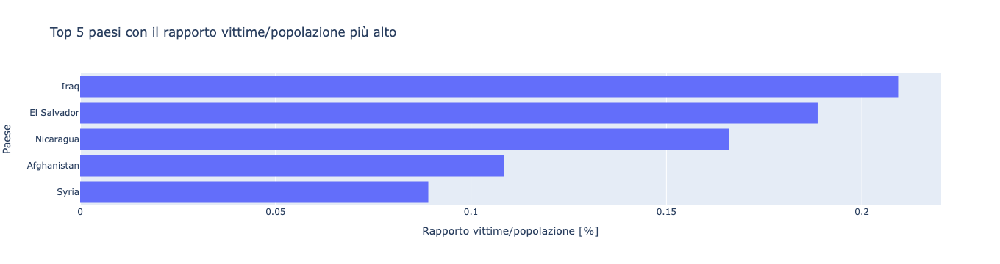

In [36]:
#5 citta con più morti in proporzione alla popolazione
df_population_2017 = df_population[["Country", "2017"]]
df_ckill= df_terrorism.groupby(["Country"])["Killed"].sum().reset_index()
df_wp_all_wu = pd.merge(df_ckill, df_population_2017, how="left", on="Country")
df_wp_all_wu["Ratio"] = df_wp_all_wu["Killed"] / df_wp_all_wu["2017"] * 100
df_wp_all_wu = df_wp_all_wu.sort_values(by=["Ratio"], ascending = False).head(5)

# Mostra grafico
fig = px.histogram(df_wp_all_wu, y="Country", x="Ratio", title="Top 5 paesi con il rapporto vittime/popolazione più alto").update_yaxes(categoryorder="total ascending")
fig.layout["yaxis"]["title"] = "Paese"
fig.layout["xaxis"]["title"] = "Rapporto vittime/popolazione [%]"
fig

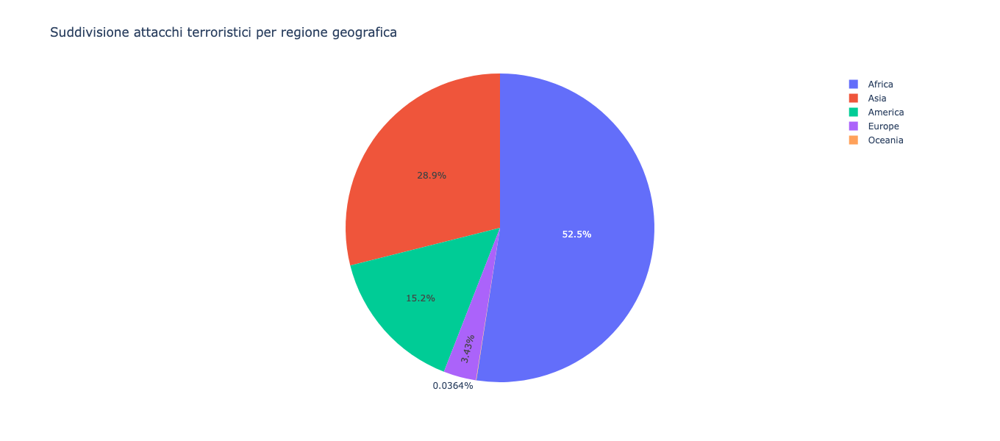

In [ ]:
fig = px.pie(df_terrorism, names="Region", title="Suddivisione attacchi terroristici per regione geografica", values="Killed", height=600)
fig

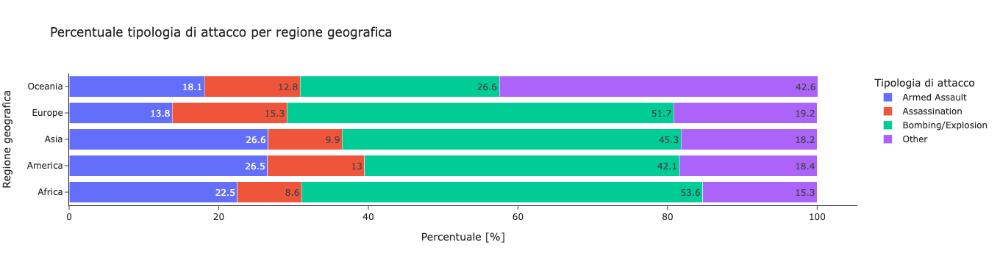

In [ ]:
#tipologia attacco percentuale
df_at_all = df_terrorism.groupby(["AttackType"]).size().to_frame().sort_values([0], ascending = False).reset_index()
df_at = df_at_all.head(3)
df_at.columns = ["AttackType", "Count"]

#setto other
df_at_all = df_at_all.iloc[3:]
df_at_all["AttackType"] = "Other"
new_row = pd.DataFrame([["Other", (df_at_all.groupby(["AttackType"]).sum()[0]["Other"])]], columns=["AttackType", "Count"])
df_at = pd.concat([df_at, new_row], ignore_index=True)

#group by region
df_at_region = df_terrorism.groupby(["Region", "AttackType"]).size().to_frame().sort_values([0], ascending = False).reset_index()

#setto gli attack type
for index, row in df_at_region.iterrows():
    if(~df_at["AttackType"].str.contains(df_at_region["AttackType"][index]).any()):
        df_at_region["AttackType"][index] = "Other"

df_at_region.columns = ["Region", "AttackType", "Count"]
df_at_region = df_at_region.groupby(["Region", "AttackType"])["Count"].sum().reset_index()

#calcolo percentuale
df_at_region["Percentage"] = 0
for index, row in df_at_region.iterrows():
    region = str(row["Region"])
    df_region = df_at_region[df_at_region["Region"] == region]
    sum_attacks = df_region["Count"].sum()
    percentage = row["Count"] / sum_attacks * 100
    df_at_region["Percentage"][index] = round(percentage, 1)


fig= px.bar(df_at_region, 
             y = "Region", 
             x = "Percentage",
            title = "Percentuale tipologia di attacco per regione geografica",
             color = "AttackType", 
             barmode = "stack", 
             text=df_at_region["Percentage"],
             labels={"AttackType": "Tipologia di attacco"},
            hover_data=df_at_region.columns
           )
fig.layout["yaxis"]["title"] = "Regione geografica"
fig.layout["xaxis"]["title"] = "Percentuale [%]"
fig.update_layout(template = "simple_white")
fig

#### Analisi Svizzera

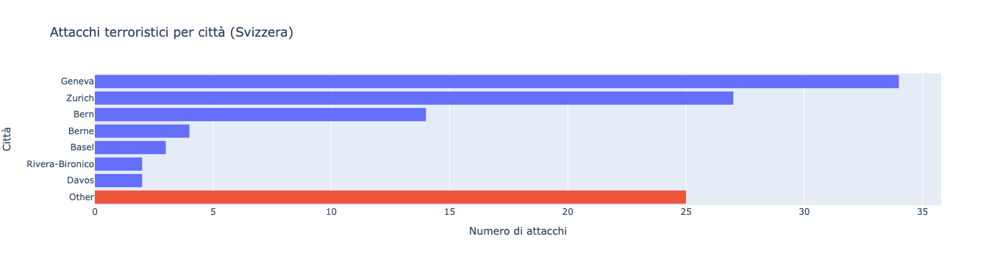

In [ ]:
#Filto per attacchi svizzeri
df_ts = df_terrorism[df_terrorism["Country"] == "Switzerland"]
df_ts_c = df_ts[["city"]]

#Top 7 obbiettivi
df_ts_c = df_ts_c.groupby(["city"]).size().to_frame().sort_values([0], ascending = False).reset_index()
df_tsc = df_ts_c.head(7)
df_tsc.columns = ["city", "Count"]

#Raggruppamento restanti obbiettivi
df_ts_c = df_ts_c.iloc[7:]
df_ts_c["city"] = "Other"
new_row = pd.DataFrame([["Other", (df_ts_c.groupby(["city"]).sum()[0]["Other"])]], columns=["city", "Count"])
df_ts_col = pd.concat([df_tsc, new_row], ignore_index=True)

#Cambiamento colore per Other
df_ts_col["Color"] = "1"
df_ts_col.loc[df_ts_col["city"] == "Other", "Color"] = "2"

fig = px.histogram(df_ts_col, y="city", x="Count", color="Color", title="Attacchi terroristici per città (Svizzera)")
fig.layout["xaxis"]["title"] = "Numero di attacchi"
fig.layout["yaxis"]["title"] = "Città"
fig.layout["yaxis"]["autorange"] = "reversed"
fig.update_layout(showlegend=False)
fig

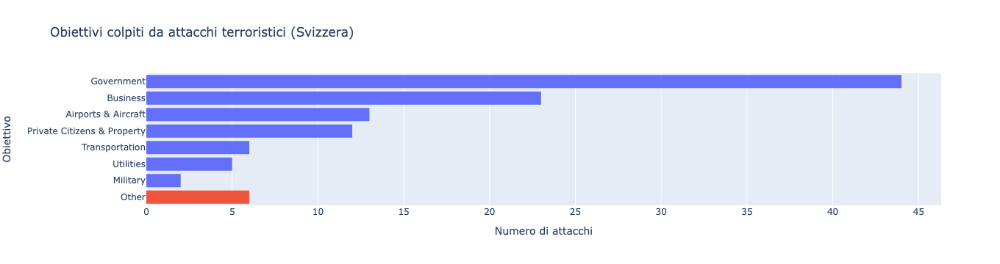

In [ ]:
#Filtro Target
df_ts_c = df_ts[["Target_type"]]
df_ts_c.loc[df_ts_c["Target_type"].str.contains("Government"), "Target_type"] = "Government"

#Top 7 obbiettivi
df_ts_c = df_ts_c.groupby(["Target_type"]).size().to_frame().sort_values([0], ascending = False).reset_index()
df_tsc = df_ts_c.head(7)
df_tsc.columns = ["Target_type", "Count"]

#Raggruppamento restanti obbiettivi
df_ts_c = df_ts_c.iloc[7:]
df_ts_c["Target_type"] = "Other"
new_row = pd.DataFrame([["Other", (df_ts_c.groupby(["Target_type"]).sum()[0]["Other"])]], columns=["Target_type", "Count"])
df_ts_col = pd.concat([df_tsc, new_row], ignore_index=True)

#Cambiamento colore per Other
df_ts_col["Color"] = "1"
df_ts_col.loc[df_ts_col["Target_type"] == "Other", "Color"] = "2"

fig = px.histogram(df_ts_col, y="Target_type", x="Count", color="Color", title="Obiettivi colpiti da attacchi terroristici (Svizzera)")
fig.layout["xaxis"]["title"] = "Numero di attacchi"
fig.layout["yaxis"]["title"] = "Obiettivo"
fig.layout["yaxis"]["autorange"] = "reversed"
fig.update_layout(showlegend=False)
fig


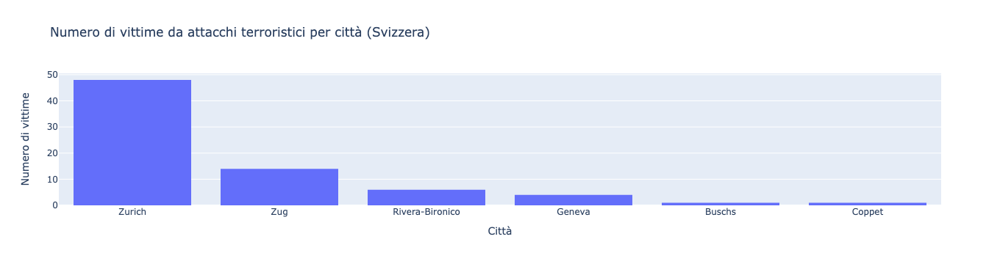

In [ ]:
#Attacchi con almento una vittima
dfs = df_ts[df_ts["Killed"] > 0]

fig = px.histogram(dfs, x="city", y="Killed", title="Numero di vittime da attacchi terroristici per città (Svizzera)").update_xaxes(categoryorder="total descending")
fig.layout["yaxis"]["title"] = "Numero di vittime"
fig.layout["xaxis"]["title"] = "Città"
fig

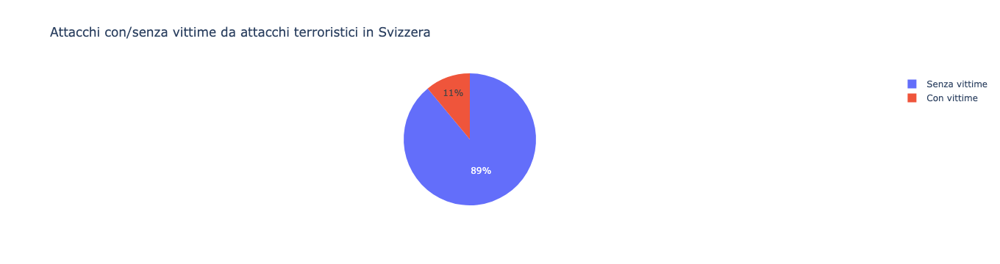

In [ ]:
#Vittime/senza vittime
df_ts = df_ts[~df_ts["Killed"].isnull()]
df_ts["Kill"] = "Con vittime"
df_ts.loc[df_ts["Killed"] == 0, "Kill"] = "Senza vittime"

fig = px.pie(df_ts, names="Kill", title="Attacchi con/senza vittime da attacchi terroristici in Svizzera")
fig

#### Analisi Italia

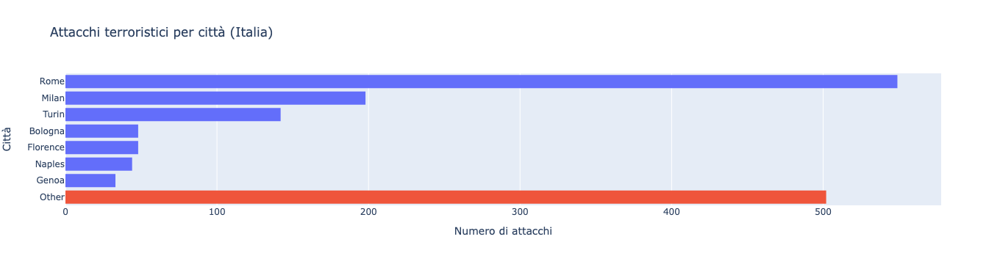

In [ ]:
#Filto per attacchi italia
df_ts = df_terrorism[df_terrorism["Country"] == "Italy"]
df_ts_c = df_ts[["city"]]

#Top 7 obbiettivi
df_ts_c = df_ts_c.groupby(["city"]).size().to_frame().sort_values([0], ascending = False).reset_index()
df_tsc = df_ts_c.head(7)
df_tsc.columns = ["city", "Count"]

#Raggruppamento restanti obbiettivi
df_ts_c = df_ts_c.iloc[7:]
df_ts_c["city"] = "Other"
new_row = pd.DataFrame([["Other", (df_ts_c.groupby(["city"]).sum()[0]["Other"])]], columns=["city", "Count"])
df_ts_col = pd.concat([df_tsc, new_row], ignore_index=True)

#Cambiamento colore per Other
df_ts_col["Color"] = "1"
df_ts_col.loc[df_ts_col["city"] == "Other", "Color"] = "2"

fig = px.histogram(df_ts_col, y="city", x="Count", color="Color", title="Attacchi terroristici per città (Italia)")
fig.layout["xaxis"]["title"] = "Numero di attacchi"
fig.layout["yaxis"]["title"] = "Città"
fig.layout["yaxis"]["autorange"] = "reversed"
fig.update_layout(showlegend=False)
fig

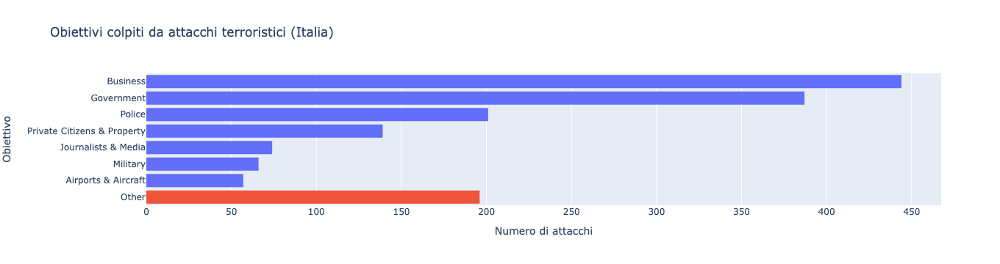

In [ ]:
#Filtro Target
df_ts_c = df_ts[["Target_type"]]
df_ts_c.loc[df_ts_c["Target_type"].str.contains("Government"), "Target_type"] = "Government"

#Top 7 obbiettivi
df_ts_c = df_ts_c.groupby(["Target_type"]).size().to_frame().sort_values([0], ascending = False).reset_index()
df_tsc = df_ts_c.head(7)
df_tsc.columns = ["Target_type", "Count"]

#Raggruppamento restanti obbiettivi
df_ts_c = df_ts_c.iloc[7:]
df_ts_c["Target_type"] = "Other"
new_row = pd.DataFrame([["Other", (df_ts_c.groupby(["Target_type"]).sum()[0]["Other"])]], columns=["Target_type", "Count"])
df_ts_col = pd.concat([df_tsc, new_row], ignore_index=True)

#Cambiamento colore per Other
df_ts_col["Color"] = "1"
df_ts_col.loc[df_ts_col["Target_type"] == "Other", "Color"] = "2"

fig = px.histogram(df_ts_col, y="Target_type", x="Count", color="Color", title="Obiettivi colpiti da attacchi terroristici (Italia)")
fig.layout["xaxis"]["title"] = "Numero di attacchi"
fig.layout["yaxis"]["title"] = "Obiettivo"
fig.layout["yaxis"]["autorange"] = "reversed"
fig.update_layout(showlegend=False)
fig


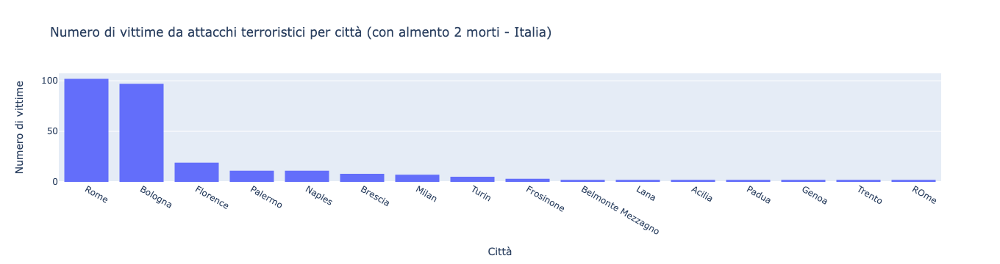

In [ ]:
#Attacchi con almento una vittima
dfs = df_ts[df_ts["Killed"] > 1]

fig = px.histogram(dfs, x="city", y="Killed", title="Numero di vittime da attacchi terroristici per città (con almento 2 morti - Italia)").update_xaxes(categoryorder="total descending")
fig.layout["yaxis"]["title"] = "Numero di vittime"
fig.layout["xaxis"]["title"] = "Città"
fig

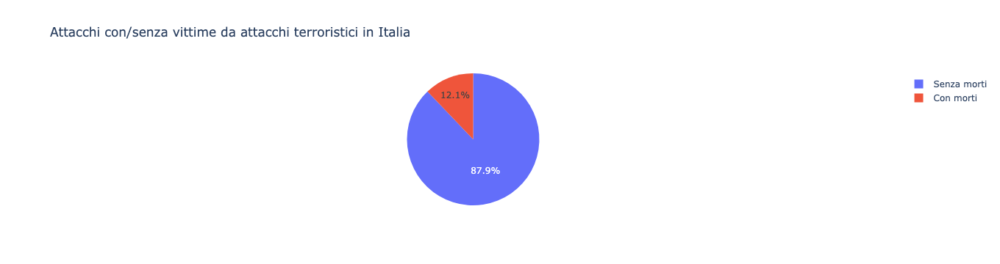

In [ ]:
#Vittime/senza vittime
df_ts = df_ts[~df_ts["Killed"].isnull()]
df_ts["Kill"] = "Con morti"
df_ts.loc[df_ts["Killed"] == 0, "Kill"] = "Senza morti"

fig = px.pie(df_ts, names="Kill", title="Attacchi con/senza vittime da attacchi terroristici in Italia")
fig